# DA: model fitting

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import tqdm
from scipy.optimize import minimize
import emcee
import corner
from IPython.display import display, Math

data = pd.read_csv('data_1.csv', names=['ID', 'x', 'y', 'sigma_y', 'sigma_x', 'rho_xy'])


In [2]:
N = 30
coeff = [1, 2]
x = np.random.rand(N)
y_err = np.random.rand(N)*0.01 - 0.01/2 + 0.2
y = np.polyval(coeff, x) + np.random.randn(N) * y_err
A = np.concatenate([[[1]*N], [x]], axis=0).T
Y = y.reshape(30,1)
C = np.zeros([N, N])
for i in range(N):
    C[i, i] = y_err[i]**2

<ErrorbarContainer object of 3 artists>

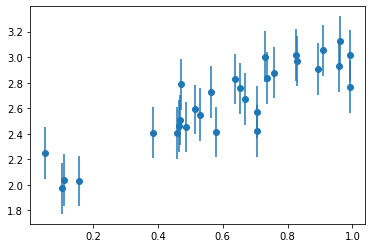

In [3]:
plt.errorbar(x, y, yerr=y_err, fmt='o')

In [11]:
RT_1 = A.T.dot(np.linalg.inv(C).dot(Y))
LT_1 = A.T.dot(np.linalg.inv(C).dot(A))
np.linalg.inv(LT_1).dot(RT_1)

array([[1.99701581],
       [1.06291464]])

## Exercise 1

### 1-1

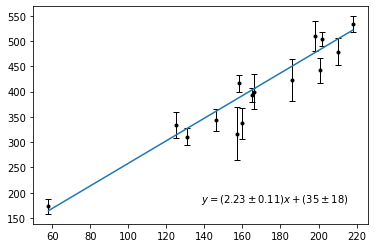

In [4]:
# Read the data
x = data.loc[5:, 'x'].values
y = data.loc[5:, 'y'].values
y_err = data.loc[5:, 'sigma_y'].values

# Calculate the matrixes
A = np.concatenate([[[1]*len(x)], [x]], axis=0).T
Y = y.reshape(len(x),1)
C = np.zeros([len(x), len(x)])
for i in range(len(x)):
    C[i, i] = y_err[i]**2

RT_1 = A.T.dot(np.linalg.inv(C).dot(Y))
LT_1 = A.T.dot(np.linalg.inv(C).dot(A))
res = np.linalg.inv(LT_1).dot(RT_1)
cov = np.linalg.inv(LT_1)

# Plot the result
ax = plt.subplot()
plt.errorbar(x, y, yerr=y_err, fmt='.', ecolor='black', color='black',elinewidth=1,capsize=3)
x_plot = [min(x), max(x)]
plt.plot(x_plot, np.polyval([res[1], res[0]], x_plot))

plt.text(0.5, 0.1, '$y=({:.2f}\pm{:.2f})x + ({:.0f}\pm{:.0f})$'.format(res[1][0], cov[1,1]**0.5, res[0][0], cov[0,0]**0.5), transform=ax.transAxes);

## 1-2

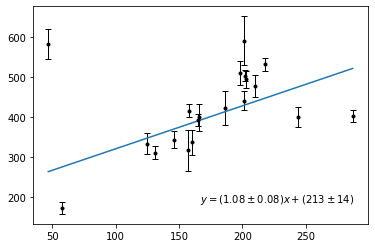

In [14]:
# Read the data
x = data.loc[:, 'x'].values
y = data.loc[:, 'y'].values
y_err = data.loc[:, 'sigma_y'].values

# Calculate the matrixes
A = np.concatenate([[[1]*len(x)], [x]], axis=0).T
Y = y.reshape(len(x),1)
C = np.zeros([len(x), len(x)])
for i in range(len(x)):
    C[i, i] = y_err[i]**2

RT_1 = A.T.dot(np.linalg.inv(C).dot(Y))
LT_1 = A.T.dot(np.linalg.inv(C).dot(A))
res = np.linalg.inv(LT_1).dot(RT_1)
cov = np.linalg.inv(LT_1)

# Plot the result
ax = plt.subplot()
plt.errorbar(x, y, yerr=y_err, fmt='.', ecolor='black', color='black',elinewidth=1,capsize=3)
x_plot = [min(x), max(x)]
plt.plot(x_plot, np.polyval([res[1], res[0]], x_plot))

plt.text(0.5, 0.1, '$y=({:.2f}\pm{:.2f})x + ({:.0f}\pm{:.0f})$'.format(res[1][0], cov[1,1]**0.5, res[0][0], cov[0,0]**0.5), transform=ax.transAxes);

## 1-3

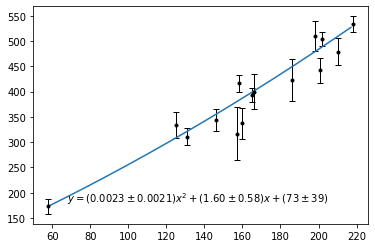

In [12]:
# Read the data
x = data.loc[5:, 'x'].values
y = data.loc[5:, 'y'].values
y_err = data.loc[5:, 'sigma_y'].values

# Calculate the matrixes
A = np.concatenate([[[1]*len(x)], [x], [x**2]], axis=0).T
Y = y.reshape(len(x),1)
C = np.zeros([len(x), len(x)])
for i in range(len(x)):
    C[i, i] = y_err[i]**2

RT_1 = A.T.dot(np.linalg.inv(C).dot(Y))
LT_1 = A.T.dot(np.linalg.inv(C).dot(A))
res = np.linalg.inv(LT_1).dot(RT_1)
cov = np.linalg.inv(LT_1)

# Plot the result
ax = plt.subplot()
plt.errorbar(x, y, yerr=y_err, fmt='.', ecolor='black', color='black',elinewidth=1,capsize=3)
x_plot = np.arange(min(x), max(x), 1)
plt.plot(x_plot, np.polyval([res[2], res[1], res[0]], x_plot))

plt.text(0.1, 0.1, '$y=({:.4f}\pm{:.4f})x^2 + ({:.2f}\pm{:.2f})x + ({:.0f}\pm{:.0f})$'.format(res[2][0], cov[2,2]**0.5, res[1][0], cov[1,1]**0.5, res[0][0], cov[0,0]**0.5), transform=ax.transAxes);


## Exereise 6

In [2]:
def cal_likelihood(x, y, sigma_y, m, b, Pb, Yb, Vb):
    likelihood_fg = (1-Pb) / np.sqrt(2*np.pi*sigma_y**2) * np.exp(- (y - m*x-b)**2 / (2*sigma_y**2))
    likelihood_bg =   Pb   / np.sqrt(2*np.pi*(Vb + sigma_y**2)) * np.exp(- (y - Yb)**2 / (2*(Vb + sigma_y**2)))
    likelihood_array = likelihood_fg + likelihood_bg
    likelihood_prod = np.prod(likelihood_array)

    # print(likelihood_fg)

    return likelihood_prod

# Set the paarameter space
m_range = np.arange(1.8, 2.8, 0.1)
b_range = np.arange(-50, 100, 1)
Pb_range = np.arange(0, 1.01, 0.1)
Yb_range = np.arange(100, 501, 70)
Vb_range = np.arange(100, 301, 70)

grid = np.meshgrid(m_range, b_range, Pb_range, Yb_range, Vb_range)
grid_flatten = [i.flatten() for i in grid]

likelihood_list = []
for i in tqdm.tqdm(range(len(grid_flatten[0]))):
    likelihood_single = cal_likelihood(data['x'], data['y'], data['sigma_y'], grid_flatten[0][i], grid_flatten[1][i], grid_flatten[2][i], grid_flatten[3][i], grid_flatten[4][i])
    likelihood_list.append(likelihood_single)

likelihood_array = likelihood_list / max(likelihood_list)

likelihood_mar_list = []
for i in m_range:
    for j in b_range:
        likelihood_single = np.sum(likelihood_array[(grid_flatten[0] == i) & (grid_flatten[1] == j)])
        likelihood_mar_list.append(likelihood_single)
likelihood_mar_list = likelihood_mar_list / max(likelihood_mar_list)

100%|██████████| 415800/415800 [15:56<00:00, 434.85it/s]


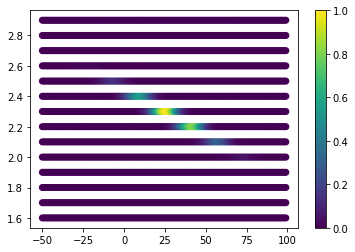

In [3]:
plot_grid = np.meshgrid(b_range, m_range)
likelihood_mar_list = np.reshape(np.array(likelihood_mar_list), plot_grid[0].shape)

plt.scatter(*plot_grid, c=likelihood_mar_list)
plt.colorbar()

## Exercise 8

In [19]:
np.linalg.inv(LT_1)**0.5

array([[14.39403311,         nan],
       [        nan,  0.07740678]])

In [44]:
# Read the data
x = data.loc[:, 'x'].values
y = data.loc[:, 'y'].values
y_err = data.loc[:, 'sigma_y'].values

m_array = []
b_array = []
for _ in range(150):
    # Select a sample
    idx = np.random.choice(np.arange(len(x)), len(x))
    x_sample = x[idx]
    y_sample = y[idx]
    y_sample_err = y_err[idx]

    # Calculate the matrixes
    A = np.concatenate([[[1]*len(x_sample)], [x_sample]], axis=0).T
    Y = y_sample.reshape(len(x_sample),1)
    C = np.zeros([len(x_sample), len(x_sample)])
    for i in range(len(x_sample)):
        C[i, i] = y_sample_err[i]**2

    RT_1 = A.T.dot(np.linalg.inv(C).dot(Y))
    LT_1 = A.T.dot(np.linalg.inv(C).dot(A))
    res = np.linalg.inv(LT_1).dot(RT_1)

    m_array.append(res[1][0])
    b_array.append(res[0][0])


# cov = np.linalg.inv(LT_1)

# # Plot the result
# ax = plt.subplot()
# plt.errorbar(x, y, yerr=y_err, fmt='.', ecolor='black', color='black',elinewidth=1,capsize=3)
# x_plot = [min(x), max(x)]
# plt.plot(x_plot, np.polyval([res[1], res[0]], x_plot))

# plt.text(0.5, 0.1, '$y=({:.2f}\pm{:.2f})x + ({:.0f}\pm{:.0f})$'.format(res[1][0], cov[1,1]**0.5, res[0][0], cov[0,0]**0.5), transform=ax.transAxes);

In [48]:
print(np.std(b_array), np.std(m_array))

104.4942919730366 0.5840877660935628


## Exercise 9

In [49]:
def cal_likelihood(x, y, sigma_y, m, b, Pb, Yb, Vb):
    likelihood_fg = (1-Pb) / np.sqrt(2*np.pi*sigma_y**2) * np.exp(- (y - m*x-b)**2 / (2*sigma_y**2))
    likelihood_bg =   Pb   / np.sqrt(2*np.pi*(Vb + sigma_y**2)) * np.exp(- (y - Yb)**2 / (2*(Vb + sigma_y**2)))
    likelihood_array = likelihood_fg + likelihood_bg
    likelihood_prod = np.prod(likelihood_array)

    # print(likelihood_fg)

    return likelihood_prod

# Set the paarameter space
m_range = np.arange(1.8, 2.8, 0.1)
b_range = np.arange(-50, 100, 1)
Pb_range = np.arange(0, 1.01, 0.1)
Yb_range = np.arange(100, 501, 70)
Vb_range = np.arange(100, 301, 70)

grid = np.meshgrid(m_range, b_range, Pb_range, Yb_range, Vb_range)
grid_flatten = [i.flatten() for i in grid]

likelihood_list = []
for i in tqdm.tqdm(range(len(grid_flatten[0]))):
    likelihood_single = cal_likelihood(data['x'], data['y'], data['sigma_y']/2, grid_flatten[0][i], grid_flatten[1][i], grid_flatten[2][i], grid_flatten[3][i], grid_flatten[4][i])
    likelihood_list.append(likelihood_single)

likelihood_array = likelihood_list / max(likelihood_list)

likelihood_mar_list = []
for i in m_range:
    for j in b_range:
        likelihood_single = np.sum(likelihood_array[(grid_flatten[0] == i) & (grid_flatten[1] == j)])
        likelihood_mar_list.append(likelihood_single)
likelihood_mar_list = likelihood_mar_list / max(likelihood_mar_list)

100%|██████████| 297000/297000 [11:11<00:00, 442.46it/s]


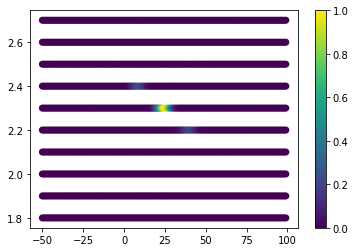

In [51]:
plot_grid = np.meshgrid(b_range, m_range)
likelihood_mar_list = np.reshape(np.array(likelihood_mar_list), plot_grid[0].shape)

plt.scatter(*plot_grid, c=likelihood_mar_list)
plt.colorbar()

## Exercise 10

In [18]:
# Read the data
x = data.loc[5:, 'x'].values
y = data.loc[5:, 'y'].values
y_err = data.loc[5:, 'sigma_y'].values

# Calculate the matrixes
A = np.concatenate([[[1]*len(x)], [x]], axis=0).T
Y = y.reshape(len(x),1)
C = np.zeros([len(x), len(x)])
for i in range(len(x)):
    C[i, i] = y_err[i]**2

RT_1 = A.T.dot(np.linalg.inv(C).dot(Y))
LT_1 = A.T.dot(np.linalg.inv(C).dot(A))
res = np.linalg.inv(LT_1).dot(RT_1)
cov = np.linalg.inv(LT_1)

chi_2 = np.transpose(Y-A.dot(res)).dot(np.linalg.inv(C)).dot(Y-A.dot(res))

In [17]:
chi_2

array([[18.58230953]])

## Exercise 11

In [53]:
# Read the data
x = data.loc[5:, 'x'].values
y = data.loc[5:, 'y'].values
y_err = data.loc[5:, 'sigma_y'].values

S_array = np.arange(100, 1500, 10)
chi_2_list = []
for S in S_array: 
    # Calculate the matrixes
    A = np.concatenate([[[1]*len(x)], [x]], axis=0).T
    Y = y.reshape(len(x),1)
    C = np.zeros([len(x), len(x)])
    for i in range(len(x)):
        C[i, i] = S

    RT_1 = A.T.dot(np.linalg.inv(C).dot(Y))
    LT_1 = A.T.dot(np.linalg.inv(C).dot(A))
    res = np.linalg.inv(LT_1).dot(RT_1)
    cov = np.linalg.inv(LT_1)

    chi_2 = np.transpose(Y-A.dot(res)).dot(np.linalg.inv(C)).dot(Y-A.dot(res))
    chi_2_list.append(chi_2[0][0])
chi_2_array = np.array(chi_2_list)

(6.0, 24.0)

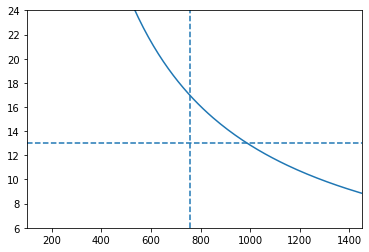

In [58]:
plt.plot(S_array, chi_2_array)
plt.axhline(len(x)-2, ls='--')
plt.axvline(np.mean(y_err**2), ls='--')
plt.xlim(100, 1450); plt.ylim(6, 24)

## Exercise 13

In [110]:
x = data.loc[4:, 'x'].values
y = data.loc[4:, 'y'].values
x_err = data.loc[4:, 'sigma_x'].values
y_err = data.loc[4:, 'sigma_y'].values

theta_array = np.arange(0, np.pi, 0.05)
b_orth_array = np.arange(0, 30, 1)

likelihood_list_all = []
for theta in tqdm.tqdm(theta_array):
    for b_orth in b_orth_array:
        likelihood_list = []
        for i in range(len(x)):
            v = np.array([[-np.sin(theta)], [np.cos(theta)]])
            Z_i = np.array([[x[i]], [y[i]]])

            S_i = np.zeros((2,2))
            S_i[0,0] = x_err[i]**2
            S_i[1,1] = y_err[i]**2
            S_i[1,0] = x_err[i] * y_err[i]
            S_i[0,1] = x_err[i] * y_err[i]

            delta_i = np.transpose(v).dot(Z_i) - b_orth
            sum_i_2 = np.transpose(v).dot(S_i).dot(v)

            likelihood_single_ = delta_i / 2 / sum_i_2
            likelihood_list.append(likelihood_single_[0][0])
        likelihood_single = np.sum(likelihood_list)
        likelihood_list_all.append(likelihood_single)

plot_grid = np.meshgrid(b_orth_array, theta_array)
likelihood_array = np.array(likelihood_list_all).reshape(plot_grid[0].shape)

100%|██████████| 63/63 [00:00<00:00, 105.48it/s]


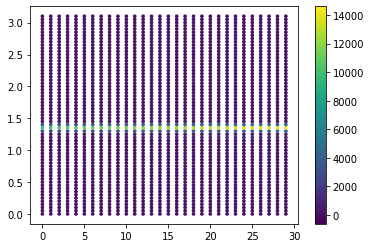

In [111]:
plt.scatter(*plot_grid, c=-likelihood_array, s=7)
plt.colorbar()

In [109]:
np.cos(np.arctan(2.2)) * 36

14.896905994842625

# EMCEE

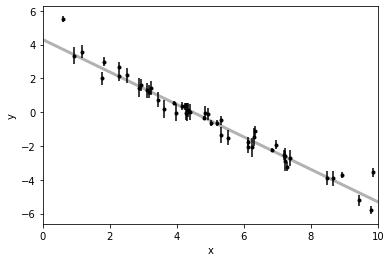

In [24]:
np.random.seed(123)

# Choose the "true" parameters.
m_true = -0.9594
b_true = 4.294
f_true = 0.2

# Generate some synthetic data from the model.
N = 50
x = np.sort(10 * np.random.rand(N))
yerr = 0.1 + 0.5 * np.random.rand(N)
y = m_true * x + b_true
y += np.abs(f_true * y) * np.random.randn(N)
y += yerr * np.random.randn(N)

plt.errorbar(x, y, yerr=yerr, fmt=".k", capsize=0)
x0 = np.linspace(0, 10, 500)
plt.plot(x0, m_true * x0 + b_true, "k", alpha=0.3, lw=3)
plt.xlim(0, 10)
plt.xlabel("x")
plt.ylabel("y");

In [3]:
def log_likelihood(theta, x, y, yerr):
    m, b, log_f = theta
    model = m * x + b
    sigma2 = yerr ** 2 + model ** 2 * np.exp(2 * log_f)
    return -0.5 * np.sum((y - model) ** 2 / sigma2 + np.log(sigma2))

Maximum likelihood estimates:
m = -0.988
b = 4.474
f = 0.155


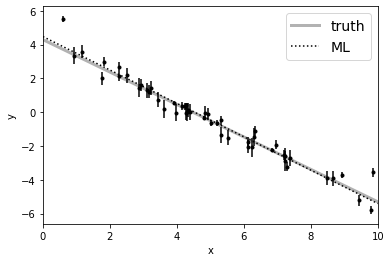

In [25]:
from scipy.optimize import minimize

np.random.seed(42)
nll = lambda *args: -log_likelihood(*args)
initial = np.array([m_true, b_true, np.log(f_true)]) + 0.1 * np.random.randn(3)
soln = minimize(nll, initial, args=(x, y, yerr))
m_ml, b_ml, log_f_ml = soln.x

print("Maximum likelihood estimates:")
print("m = {0:.3f}".format(m_ml))
print("b = {0:.3f}".format(b_ml))
print("f = {0:.3f}".format(np.exp(log_f_ml)))

plt.errorbar(x, y, yerr=yerr, fmt=".k", capsize=0)
plt.plot(x0, m_true * x0 + b_true, "k", alpha=0.3, lw=3, label="truth")
plt.plot(x0, np.dot(np.vander(x0, 2), [m_ml, b_ml]), ":k", label="ML")
plt.legend(fontsize=14)
plt.xlim(0, 10)
plt.xlabel("x")
plt.ylabel("y");

In [5]:
def log_prior(theta):
    m, b, log_f = theta
    if -5.0 < m < 0.5 and 0.0 < b < 10.0 and -10.0 < log_f < 1.0:
        return 0.0
    return -np.inf

def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)   

In [26]:
import emcee

pos = soln.x + 1e-4 * np.random.randn(32, 3)
nwalkers, ndim = pos.shape

sampler = emcee.EnsembleSampler(nwalkers, ndim, log_probability, args=(x, y, yerr))
sampler.run_mcmc(pos, 5000, progress=True);

100%|██████████| 5000/5000 [00:04<00:00, 1004.46it/s]


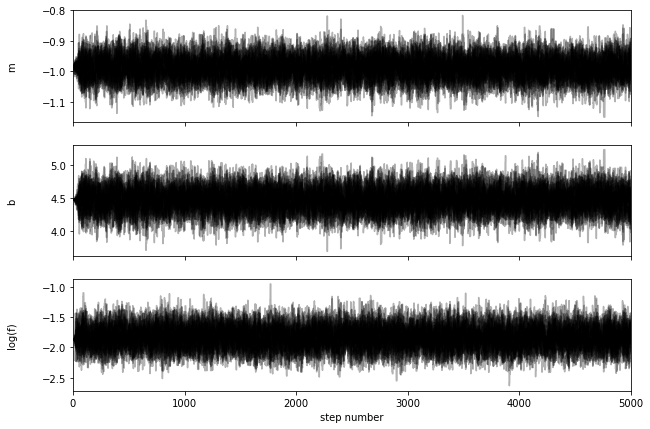

In [27]:
fig, axes = plt.subplots(3, figsize=(10, 7), sharex=True)
samples = sampler.get_chain()
labels = ["m", "b", "log(f)"]
for i in range(ndim):
    ax = axes[i]
    ax.plot(samples[:, :, i], "k", alpha=0.3)
    ax.set_xlim(0, len(samples))
    ax.set_ylabel(labels[i])
    ax.yaxis.set_label_coords(-0.1, 0.5)

axes[-1].set_xlabel("step number");

In [19]:
tau = sampler.get_autocorr_time()
print(tau)

[45.87616449 43.94876118 48.96490967]


In [29]:
flat_samples = sampler.get_chain(discard=100, thin=15, flat=True)
print(flat_samples.shape)

(10432, 3)


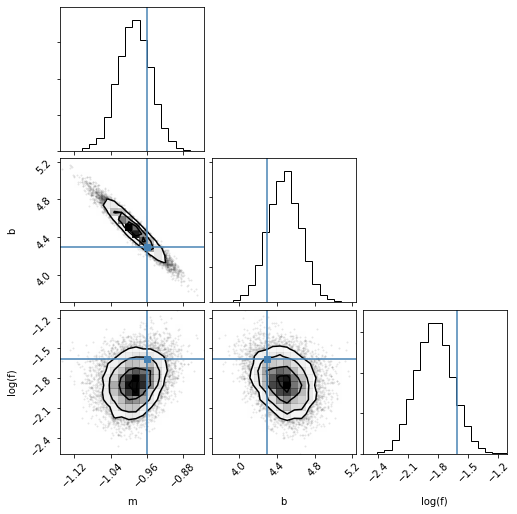

In [30]:
import corner

fig = corner.corner(
    flat_samples, labels=labels, truths=[m_true, b_true, np.log(f_true)]
);

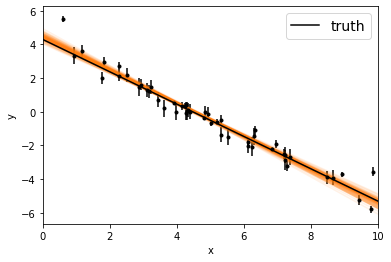

In [31]:
inds = np.random.randint(len(flat_samples), size=100)
for ind in inds:
    sample = flat_samples[ind]
    plt.plot(x0, np.dot(np.vander(x0, 2), sample[:2]), "C1", alpha=0.1)
plt.errorbar(x, y, yerr=yerr, fmt=".k", capsize=0)
plt.plot(x0, m_true * x0 + b_true, "k", label="truth")
plt.legend(fontsize=14)
plt.xlim(0, 10)
plt.xlabel("x")
plt.ylabel("y");

In [32]:
for i in range(ndim):
    mcmc = np.percentile(flat_samples[:, i], [16, 50, 84])
    q = np.diff(mcmc)
    txt = "\mathrm{{{3}}} = {0:.3f}_{{-{1:.3f}}}^{{{2:.3f}}}"
    txt = txt.format(mcmc[1], q[0], q[1], labels[i])
    display(Math(txt))

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

## My emcee

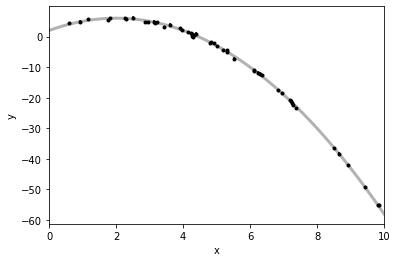

In [75]:
np.random.seed(123)

# Choose the "true" parameters.
coeff = [-1, 4, 2]

# Generate some synthetic data from the model.
N = 50
x = np.sort(10 * np.random.rand(N))
yerr = 0.1 + 0.5 * np.random.rand(N)
y = np.polyval(coeff, x)
# y += np.abs(f_true * y) * np.random.randn(N)
y += yerr * np.random.randn(N)

plt.errorbar(x, y, yerr=yerr, fmt=".k", capsize=0)
x0 = np.linspace(0, 10, 500)
plt.plot(x0, np.polyval(coeff, x0), "k", alpha=0.3, lw=3)
plt.xlim(0, 10)
plt.xlabel("x")
plt.ylabel("y");

In [57]:
def log_likelihood(theta, x, y, yerr):
    model = np.polyval(theta, x)
    sigma2 = yerr ** 2
    return -0.5 * np.sum((y - model) ** 2 / sigma2 + np.log(sigma2))

Maximum likelihood estimates:
-0.999 3.994 2.015 


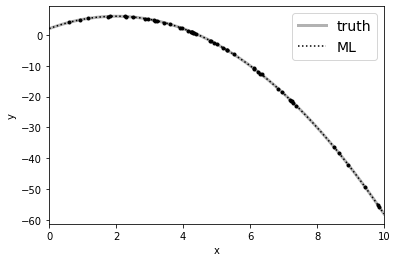

In [71]:
np.random.seed(42)
nll = lambda *args: -log_likelihood(*args)
initial = np.array([1]*len(coeff)) + 0.1 * np.random.randn(len(coeff))
soln = minimize(nll, initial, args=(x, y, yerr))
# m_ml, b_ml = soln.x

print("Maximum likelihood estimates:")
coeff_str = "{:.3f} " * len(soln.x)
print(coeff_str.format(*soln.x))

plt.errorbar(x, y, yerr=yerr, fmt=".k", capsize=0)
plt.plot(x0, np.polyval(coeff, x0), "k", alpha=0.3, lw=3, label="truth")
plt.plot(x0, np.dot(np.vander(x0, len(coeff)), soln.x), ":k", label="ML")
plt.legend(fontsize=14)
plt.xlim(0, 10)
plt.xlabel("x")
plt.ylabel("y");

In [63]:
def log_prior(theta):
    if -5.0 < theta[0] < 0.5 and 0.0 < theta[1] < 10.0 and -3 < theta[2] < 5:
        return 0.0
    return -np.inf

def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)   

In [72]:
pos = soln.x + 1e-4 * np.random.randn(52, len(soln.x))
nwalkers, ndim = pos.shape

sampler = emcee.EnsembleSampler(nwalkers, ndim, log_probability, args=(x, y, yerr))
sampler.run_mcmc(pos, 5000, progress=True);

100%|██████████| 5000/5000 [00:08<00:00, 597.42it/s]


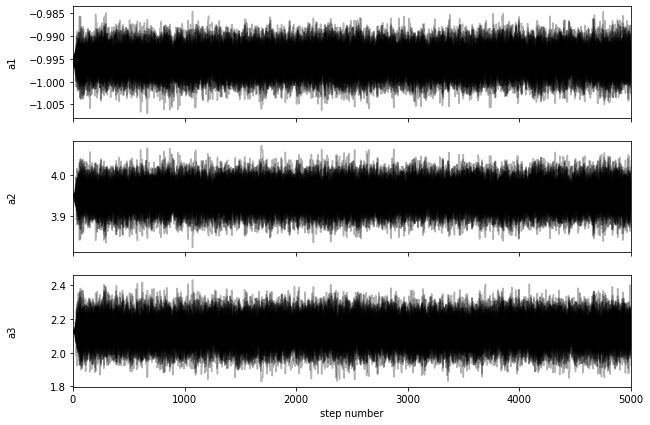

In [65]:
fig, axes = plt.subplots(len(soln.x), figsize=(10, 7), sharex=True)
samples = sampler.get_chain()
labels = ["a1", "a2", 'a3']
for i in range(ndim):
    ax = axes[i]
    ax.plot(samples[:, :, i], "k", alpha=0.3)
    ax.set_xlim(0, len(samples))
    ax.set_ylabel(labels[i])
    ax.yaxis.set_label_coords(-0.1, 0.5)

axes[-1].set_xlabel("step number");

(16952, 3)


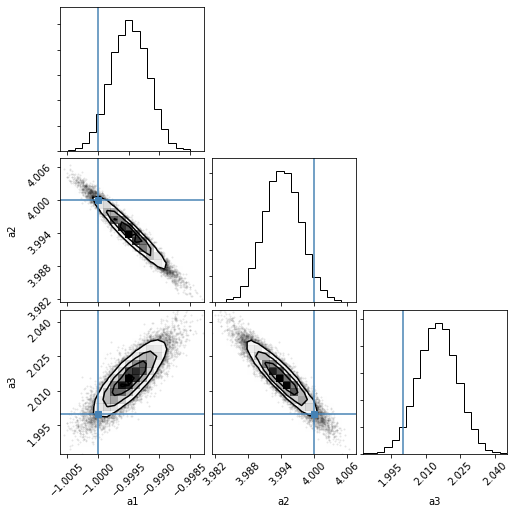

In [73]:
flat_samples = sampler.get_chain(discard=100, thin=15, flat=True)
print(flat_samples.shape)

fig = corner.corner(
    flat_samples, labels=labels, truths=coeff
);

In [74]:
for i in range(ndim):
    mcmc = np.percentile(flat_samples[:, i], [16, 50, 84])
    q = np.diff(mcmc)
    txt = "{0:.3f}_{{-{1:.3f}}}^{{{2:.3f}}}"
    txt = txt.format(mcmc[1], q[0], q[1], labels[i])
    display(Math(txt))

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

In [77]:
import rulerwd

Module "telfit" is not installed, module "telfit_wrapper" cannot be used. Don't try it :-)


In [180]:
coeff = np.array([1e-1, -1e-1, 1, 0, 0])
N = 100
x0 = np.random.rand(N) * 0.15 + 0.45
x1 = np.random.rand(N) * 2 - 1
x = [x0, x1]
y = rulerwd.fitting.poly2_mmrf(coeff, x)

yerr = 0.1 + 0.1 * np.random.rand(N)
y += yerr * np.random.randn(N)

In [168]:
def log_likelihood(coeff, x, y, yerr):
    model =  rulerwd.fitting.poly2_mmrf(coeff, x)
    sigma2 = yerr ** 2
    return -0.5 * np.sum((y - model) ** 2 / sigma2 + np.log(sigma2))

47.69741490700595

In [183]:
nll = lambda *args: -log_likelihood(*args)
initial = np.array([1]*len(coeff)) + 0.1 * np.random.randn(len(coeff))
soln = minimize(nll, initial, args=(x, y, yerr))
soln.x

array([-0.26516887,  0.66843244,  0.69178469,  0.40650797, -0.70484026])

In [135]:
def log_prior(theta):
    if np.any(theta > 2) or np.any(theta < -2):
        return 0.0
    return -np.inf

def log_probability(theta, x, y, yerr):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, x, y, yerr)   

In [148]:
pos = soln.x + 1 * soln.x * np.random.randn(52, len(soln.x))
nwalkers, ndim = pos.shape

sampler = emcee.EnsembleSampler(nwalkers, ndim, log_probability, args=(x, y, yerr))
sampler.run_mcmc(pos, 10000, progress=True);

100%|██████████| 10000/10000 [00:15<00:00, 640.07it/s]


(34320, 5)


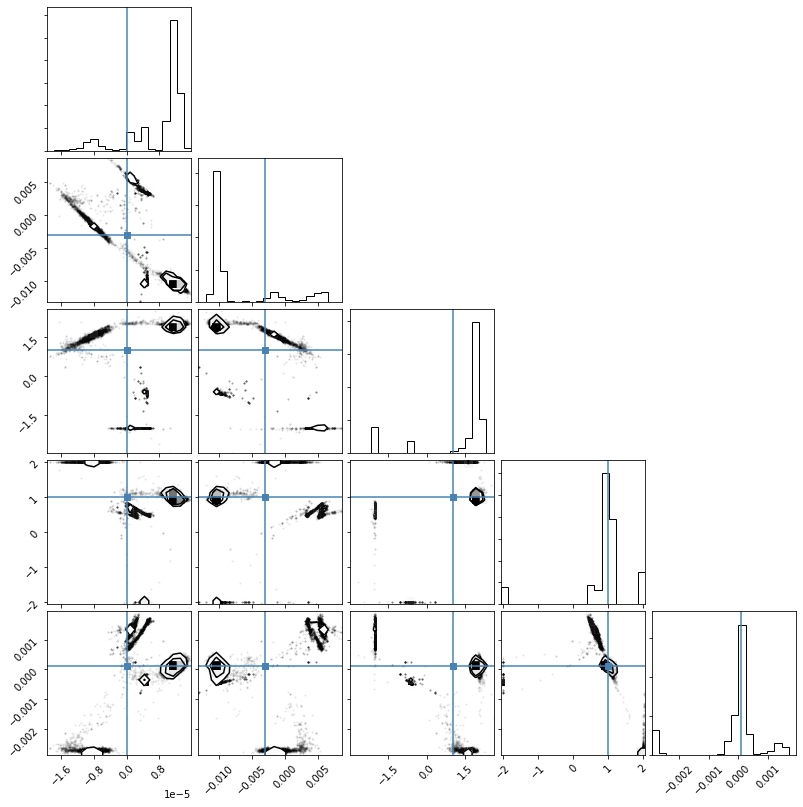

In [149]:
flat_samples = sampler.get_chain(discard=100, thin=15, flat=True)
print(flat_samples.shape)

fig = corner.corner(
    flat_samples, truths=coeff
);